<a href="https://colab.research.google.com/github/kozen88/HCV_DM23/blob/main/data_understanding.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data mining bussissness understanding

In [3]:
import pandas as pd

In [ ]:
df = pd.read_csv('HCV-Egy-Data.csv', delimiter=',')
print(df)

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import seaborn as sb
sb.set()

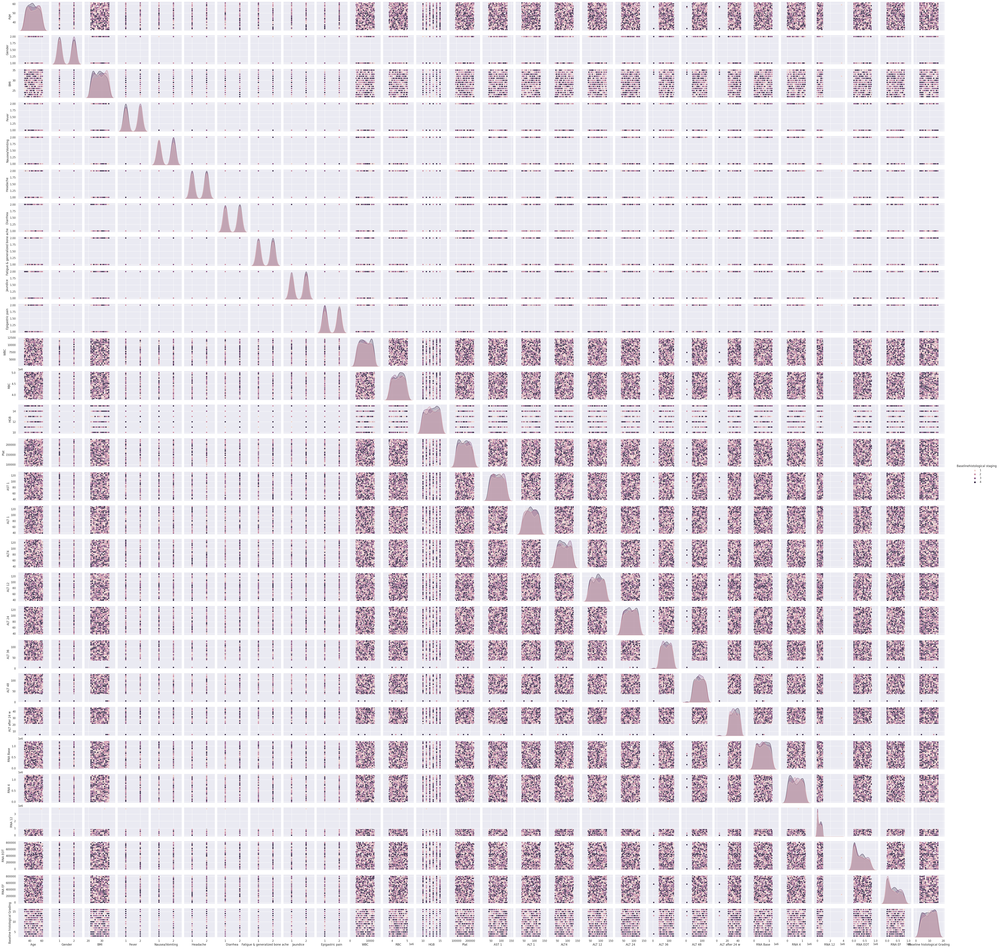

In [5]:
data_plot = sb.pairplot( df, hue='Baselinehistological staging', height=2)

la seguente funzione ci permette di estrarre proiezioni del dataset iniziale

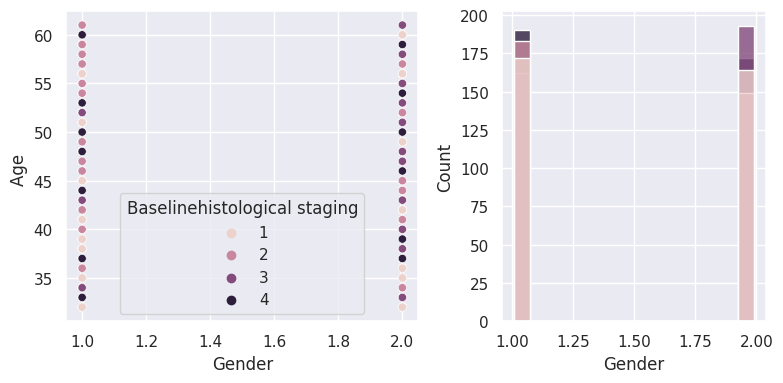

In [6]:
age_gender_relation_df = df.filter(items=['Gender','Age ', 'Baselinehistological staging'])
f, axs = plt.subplots(1, 2, figsize=(8, 4), gridspec_kw=dict(width_ratios=[4, 3]))
sb.scatterplot(data=age_gender_relation_df, x="Gender", y="Age ", hue="Baselinehistological staging", ax=axs[0])
sb.histplot(data=age_gender_relation_df, x="Gender", hue="Baselinehistological staging", shrink=.8, alpha=.8, legend=False, ax=axs[1])
f.tight_layout()

In [7]:
df.groupby('Gender').size()
samples_per_gender = list(df.groupby('Gender').size())
print(samples_per_gender)
gender = ['Male', 'Female']
map_sample_per_gender = {}
j = 0
for i in gender:
        map_sample_per_gender[i] = samples_per_gender[j]
        j = j + 1
print(map_sample_per_gender)

[707, 678]
{'Male': 707, 'Female': 678}


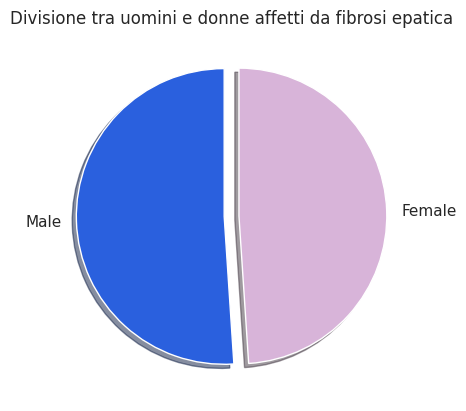

In [8]:
explode = (0.05,0.05)
plt.pie(map_sample_per_gender.values(), explode, map_sample_per_gender.keys(), colors=['#2a60de', '#d8b4d9'], shadow=True, startangle=90 )
plt.title("Divisione tra uomini e donne affetti da fibrosi epatica")
plt.show()

In [9]:
df_male = df[(df['Gender'] == 1)]
df_male.describe()
df_female =df[(df['Gender'] == 2)]
df_female.describe()

,Age,Gender,BMI,Fever,Nausea/Vomting,Headache,Diarrhea,Fatigue & generalized bone ache,Jaundice,Epigastric pain,...,ALT 36,ALT 48,ALT after 24 w,RNA Base,RNA 4,RNA 12,RNA EOT,RNA EF,Baseline histological Grading,Baselinehistological staging
count,678.000000,678.0,678.000000,678.000000,678.000000,678.000000,678.000000,678.000000,678.000000,678.000000,...,678.000000,678.000000,678.000000,6.780000e+02,6.780000e+02,678.000000,678.000000,678.000000,678.000000,678.000000
mean,46.230088,2.0,28.635693,1.526549,1.483776,1.483776,1.511799,1.522124,1.501475,1.491150,...,83.281711,83.085546,33.511799,5.861204e+05,5.922727e+05,279613.417404,297185.982301,287199.370206,9.821534,2.550147
std,8.859490,0.0,4.144904,0.499663,0.500106,0.500106,0.500230,0.499879,0.500367,0.500291,...,26.131391,25.737025,7.060972,3.504140e+05,3.560689e+05,264509.348035,268687.214561,266571.301593,4.053812,1.113762
min,32.000000,2.0,22.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,5.000000,5.000000,5.000000,4.210000e+03,7.740000e+02,5.000000,5.000000,5.000000,3.000000,1.000000
25%,39.000000,2.0,25.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,62.000000,61.000000,27.250000,2.577870e+05,2.693285e+05,5.000000,5.000000,5.000000,6.000000,2.000000
50%,46.000000,2.0,29.000000,2.000000,1.000000,1.000000,2.000000,2.000000,2.000000,1.000000,...,84.000000,83.000000,33.000000,5.908885e+05,5.884210e+05,228243.500000,282300.000000,242092.000000,10.000000,3.000000
75%,54.000000,2.0,32.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,105.000000,105.000000,40.000000,8.846700e+05,8.844405e+05,510148.500000,522468.500000,507905.250000,14.000000,4.000000
max,61.000000,2.0,35.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,128.000000,128.000000,45.000000,1.201086e+06,1.200649e+06,805218.000000,808450.000000,810333.000000,16.000000,4.000000


Studiamo rispetto alle classi gender il nostro dataset l'obiettivo è quello di capire se i problemi epatici causati dal virus HCV affligono maggiormente gli uomini o le donne cercheremo di trarre alcune conclusioni e farci un idea del fenomeno

In [10]:
male_cirrhosis = df[((df['Gender'] == 1) & (df['Baselinehistological staging'] == 4))]
female_cirrhosis = df[((df['Gender'] == 2) & (df['Baselinehistological staging'] == 4))]
male_bridging_fibrosis = df[((df['Gender'] == 1) & (df['Baselinehistological staging'] == 3))]
female_bridging_fibrosis =df[((df['Gender'] == 2) & (df['Baselinehistological staging'] == 3))]
male_periportal_fibrosis = df[((df['Gender'] == 1) & (df['Baselinehistological staging'] == 2))]
female_periportal_fibrosis = df[((df['Gender'] == 2) & (df['Baselinehistological staging'] == 2))]
male_portal_fibrosis = df[((df['Gender'] == 1) & (df['Baselinehistological staging'] == 1))]
female_portal_fibrosis = df[((df['Gender'] == 2) & (df['Baselinehistological staging'] == 1))]

controlliamo le statistiche di questi daframe creati in base al sesso e la gravità della fibrosi

In [ ]:
#male_cirrhosis.describe()
#female_cirrhosis.describe()
#male_bridging_fibrosis.describe()
#female_bridging_fibrosis.describe()
#male_periportal_fibrosis.describe()
#female_periportal_fibrosis.describe()
#male_portal_fibrosis.describe()
#female_portal_fibrosis.describe()


,Age,Gender,BMI,Fever,Nausea/Vomting,Headache,Diarrhea,Fatigue & generalized bone ache,Jaundice,Epigastric pain,...,ALT 36,ALT 48,ALT after 24 w,RNA Base,RNA 4,RNA 12,RNA EOT,RNA EF,Baseline histological Grading,Baselinehistological staging
count,164.000000,164.0,164.000000,164.000000,164.000000,164.000000,164.000000,164.000000,164.000000,164.000000,...,164.000000,164.000000,164.000000,1.640000e+02,1.640000e+02,164.000000,164.000000,164.000000,164.000000,164.0
mean,46.451220,2.0,28.548780,1.542683,1.408537,1.536585,1.518293,1.554878,1.469512,1.548780,...,84.670732,82.652439,33.463415,5.581818e+05,6.081903e+05,265772.926829,323112.737805,290420.890244,9.871951,1.0
std,9.310793,0.0,4.183381,0.499701,0.493069,0.500187,0.501196,0.498501,0.500598,0.499139,...,27.701102,25.283083,7.075743,3.734823e+05,3.693362e+05,253279.697342,281287.317112,268905.706325,3.949304,0.0
min,32.000000,2.0,22.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,39.000000,39.000000,22.000000,4.210000e+03,3.556000e+03,5.000000,5.000000,5.000000,3.000000,1.0
25%,37.750000,2.0,25.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,60.000000,61.750000,28.000000,2.029602e+05,2.650288e+05,5.000000,5.000000,5.000000,6.000000,1.0
50%,46.500000,2.0,28.000000,2.000000,1.000000,2.000000,2.000000,2.000000,1.000000,2.000000,...,86.000000,83.000000,33.000000,5.501580e+05,6.469095e+05,178097.500000,308745.500000,243657.000000,10.000000,1.0
75%,55.250000,2.0,32.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,110.000000,105.250000,40.000000,8.698962e+05,8.901170e+05,470423.500000,569784.500000,534145.500000,14.000000,1.0
max,61.000000,2.0,35.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,...,128.000000,126.000000,45.000000,1.200762e+06,1.198350e+06,787967.000000,808450.000000,810056.000000,16.000000,1.0


In [11]:
x = male_cirrhosis.groupby('Gender').size()
x1 =female_cirrhosis.groupby('Gender').size()
male_female_counting = [x.values, x1.values]
male_female_counting

[array([190]), array([172])]

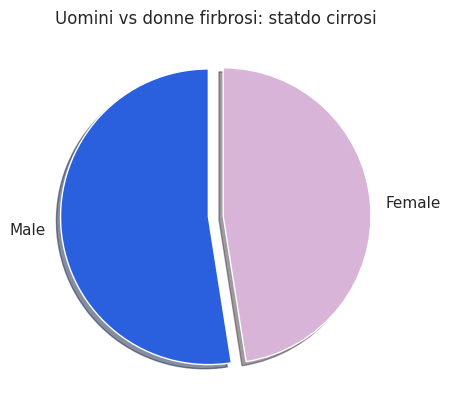

In [12]:
# primo_df.merge(secondo_df, how='outer') # merge 2 dataframe raws over raws but is nedeed to have same features
# pd.merge(primo_df, secondo_df, how='outer')
df_cirrhosis = male_cirrhosis.merge(female_cirrhosis, how='outer')
# df_cirrhosisdf.groupby('Gender').size()

# function to support data exploration
def create_map_from_dataframe(dataframe):
    samples_per_classes = list(dataframe.groupby('Gender').size())
    gender = ['Male', 'Female']
    map_sample_gender = {}
    j = 0
    for i in gender:
        map_sample_gender[i] = samples_per_classes[j]
        j = j + 1
    return map_sample_gender


def piechart_gender_comparison(map, tuple_explode, color1, color2, main_title):
    plt.pie(map.values(), tuple_explode, map.keys(),
            colors=[color1, color2], shadow=True, startangle=90)
    plt.title(main_title)
    plt.show()

blue = '#2a60de'
pink = '#d8b4d9'

map_male_female_cirrhosis = create_map_from_dataframe(df_cirrhosis)
piechart_gender_comparison(map_male_female_cirrhosis,(0.05, 0.05), blue, pink, "Uomini vs donne firbrosi: statdo cirrosi" )

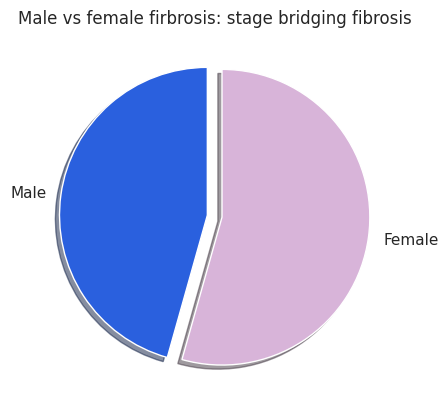

In [13]:

df_bridging_fibrosis = male_bridging_fibrosis.merge(female_bridging_fibrosis, how='outer')
# df_bridging_fibrosis
map_male_female_bf = create_map_from_dataframe(df_bridging_fibrosis)
piechart_gender_comparison(map_male_female_bf,(0.05, 0.05), blue, pink, "Male vs female firbrosis: stage bridging fibrosis" )

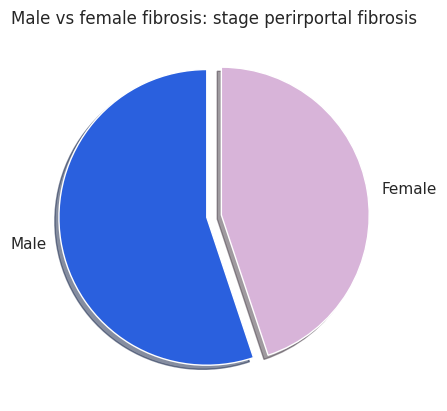

In [14]:
df_peri_portal_fibrosis = male_periportal_fibrosis.merge(female_periportal_fibrosis, how='outer')
map_male_female_ppf = create_map_from_dataframe(df_peri_portal_fibrosis)
piechart_gender_comparison(map_male_female_ppf, (0.05, 0.05), blue, pink, "Male vs female fibrosis: stage perirportal fibrosis")

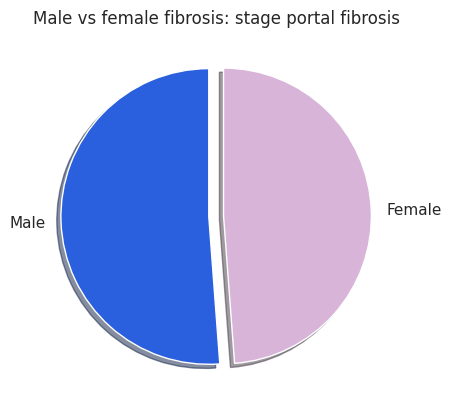

In [15]:
df_portal_fibrosis = male_portal_fibrosis.merge(female_portal_fibrosis, how='outer')
map_male_female_pf = create_map_from_dataframe(df_portal_fibrosis)
piechart_gender_comparison(map_male_female_pf, (0.05, 0.05), blue, pink, "Male vs female fibrosis: stage portal fibrosis")

Cerchiamo di studiare le correlazioni e possibili dipendenza tra le variabili per identificare variabili che hanno una forte correlazione e sulle quali sia possibile effetuare un processo di feature engeenering per ridurre la dimensionalità del dataset

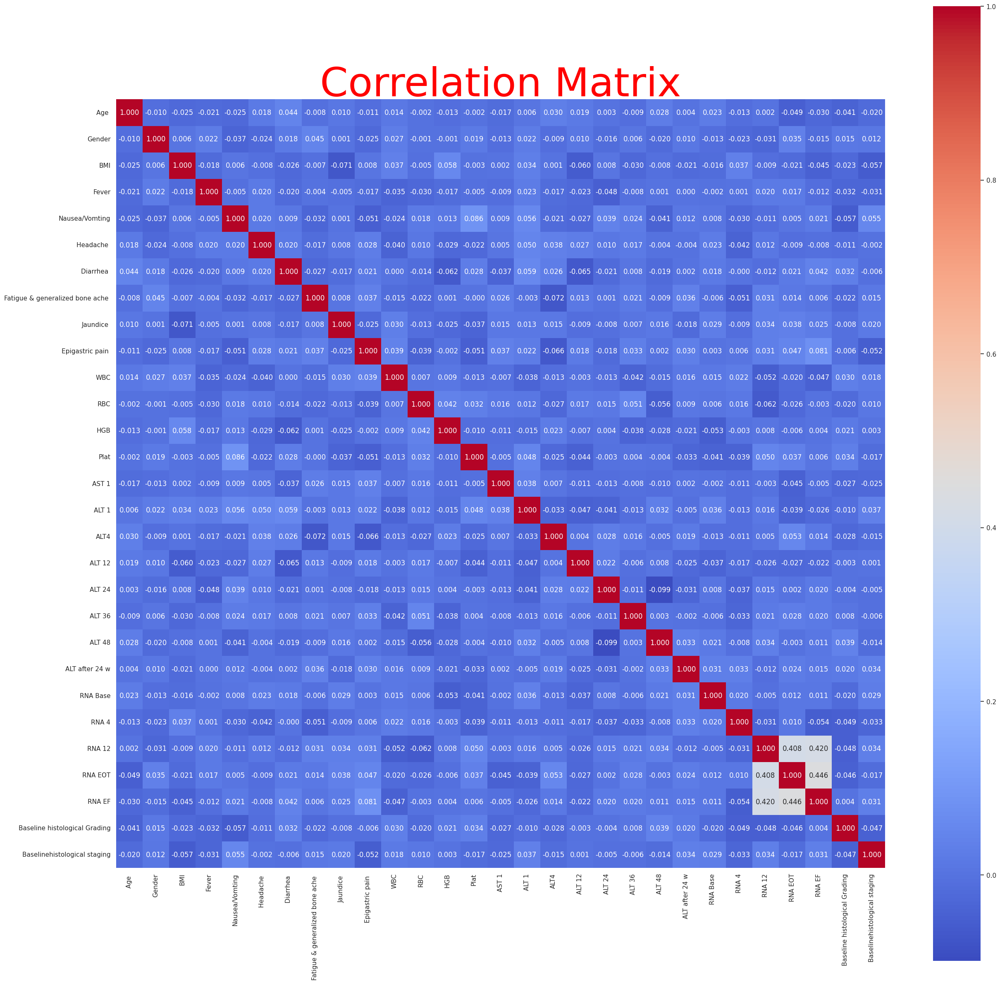

In [16]:
corr = df.corr().round(3)
mask = np.triu(np.ones_like(corr, dtype=bool))

custom_cmap = sb.color_palette("coolwarm", as_cmap=True)
plt.figure(figsize=(30, 30))
sb.heatmap(corr, annot=True, cmap=custom_cmap, square=True, fmt='.3f')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.title('Correlation Matrix', fontsize=70, color='red')
plt.show()

Dalla matrice di correlazione delle feature non si evidenziano dipendenze marcate anzi sembra che le features siano per lo più indipendenti le une dalle altre. Tuttavia è emersa una correlazione dalla matrice e cercheremo di sfruttarla al meglio per ridurre la dimensione del nostro dataset visto che le feature di partenza sono 29. Cerchiamo di compattarle in un unica feature tramite la PCA.

In [17]:
df_projectionRNA = df[['RNA EF', 'RNA EOT', 'RNA 12']]
df_projectionRNA.to_excel("projection_on_RNAef-eot-12.xlsx")
df_projectionRNA.describe()


,RNA EF,RNA EOT,RNA 12
count,1385.000000,1385.000000,1.385000e+03
mean,291378.290975,287660.336462,2.887536e+05
std,267700.691713,264559.525070,2.853507e+05
min,5.000000,5.000000,5.000000e+00
25%,5.000000,5.000000,5.000000e+00
50%,244049.000000,251376.000000,2.343590e+05
75%,527864.000000,517806.000000,5.248190e+05
max,810333.000000,808450.000000,3.731527e+06


dopo aver effettuato la summarize del nuovo data set estratto dall'originale come una sua proiezione ci accorgiamo di alcuni problemi un minimo troppo basso, nella descrizione del dataset non erano riportate le metodologie biotecniche con le quali analizzano RNA hcv per verificare la presenza di forte infezione da hepivirus della categoria c. Dopo ricerche effettuate le quali saranno specificatamente docunebtate abbiamo ottenuta una reference per i test largamente più utilizzati la quale cui tabella riportiamo nella documentazione, ma in particolare mostra le ultime righe che sembrano i test più coerenti con il nostro data set viste le oscillazioni dei valori ad ogni modo nessuno dei test giustifica il valore 5 come minimo valore.

Per affrontare il problema effettueremo una più ampia proiezione del data set di partenza in modo da confrontare le colonne che riportano 5 come valore con le altre misurazione di RNA HCV e le valuteremo con le restanti misurazioni di RNA in quanto esse danno un idea cumulativa nel tempo a confronto con lo stadio del danno epatico e con il quadro delle transaminasi per capire se il soggetto è stato infettato con il virus del HCV o meno, in caso di non infezione assumeremo che il 5 sia il valore minimo del test e lo sostituiremo con il minimo indicato dal range del test che prenderemo come riferimente in caso contrario che l'infezione da HCV ci sia o ci sia stata in forma acuta e successivamente attenuata dai trattametnti andremo a valutare quale azione di data cleaning perseguire

In [21]:
df_projection_full_RNA = df[['RNA Base', 'RNA 4', 'RNA 12', 'RNA EOT', 'RNA EF','Baselinehistological staging']]
df_projection_full_RNA.to_excel("proj_on_full_RNA.xlsx")
df_projection_full_RNA.describe()
# df_projection_full_RNA
df_pfull_RNA_without_targert = df_projection_full_RNA.drop('Baselinehistological staging', axis=1)
df_pfull_RNA_without_targert.describe()

,RNA Base,RNA 4,RNA 12,RNA EOT,RNA EF
count,1.385000e+03,1.385000e+03,1.385000e+03,1385.000000,1385.000000
mean,5.909512e+05,6.008956e+05,2.887536e+05,287660.336462,291378.290975
std,3.539354e+05,3.623151e+05,2.853507e+05,264559.525070,267700.691713
min,1.100000e+01,5.000000e+00,5.000000e+00,5.000000,5.000000
25%,2.692530e+05,2.708930e+05,5.000000e+00,5.000000,5.000000
50%,5.931030e+05,5.978690e+05,2.343590e+05,251376.000000,244049.000000
75%,8.867910e+05,9.090930e+05,5.248190e+05,517806.000000,527864.000000
max,1.201086e+06,1.201715e+06,3.731527e+06,808450.000000,810333.000000


Dalla tabella visualizzata è possibile osservare in molti casi un diminuzione dei valori di RNA-HCV per tali ragioni e la questo avrebbe anche senso visto che i pazienti sono monitorati con i test dal momento i cui hanno il problema per ammissione al servizio sanitario e da li in poi iniziano con il trattamento di antivirali, restano comunque dei casi anomali che non seguono questo andamento probabili outlier o errori di misurazione. Per meglio visualizzare il l'andamento proviamo a plottare qualche istogramma.

In [ ]:
# estraiamo le medie di ogni colonna del data set proiezione sul full screen del RNA
# df_projection_full_RNA = df_projection_full_RNA.drop('Baselinehistological staging', axis=1)


In [22]:
means_full_RNA = df_pfull_RNA_without_targert.mean().tolist()
means_full_RNA

[590951.2187725632,
 600895.6498194946,
 288753.61227436824,
 287660.33646209387,
 291378.2909747292]

In [23]:
column_full_RNA = df_pfull_RNA_without_targert.columns.tolist()
column_full_RNA

['RNA Base', 'RNA 4', 'RNA 12', 'RNA EOT', 'RNA EF']

In [24]:
map_RNA_full_means = {key: val for key, val in zip(column_full_RNA, means_full_RNA)}
map_RNA_full_means

{'RNA Base': 590951.2187725632,
 'RNA 4': 600895.6498194946,
 'RNA 12': 288753.61227436824,
 'RNA EOT': 287660.33646209387,
 'RNA EF': 291378.2909747292}

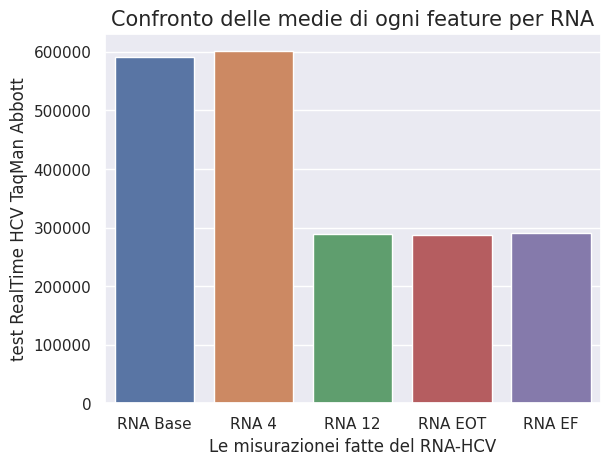

In [25]:
sb.barplot(x=list(map_RNA_full_means.keys()), y=list(map_RNA_full_means.values()))
plt.title('Confronto delle medie di ogni feature per RNA',fontsize=15)
plt.xlabel('Le misurazionei fatte del RNA-HCV')
plt.ylabel('test RealTime HCV TaqMan Abbott')
plt.show()

L'istogramma conferma le nostre ipotesi che si attestano verificate infatti in base al trattamento sotto anti-virale i pazienti in media tendono a migliorare e l' attivita di sitesi polimerale da parte del virus HCV tende a diminuire, per il momento giuinti alla comprensione del dataset e dello specifico settore che stiamo trattando non ci preoccupiamo della misurazione sul RNA EF ancora in fase di ricerca per capire se si intenda un test diverso da gli altri oppure se è lo stesso sotto particolari condizione le quali non ci vengono fornite.

Procediamo ad analizzare l'andamento dei test del sangue su AST e ALT, dei quali solo il secondo viene ad essere ripetuto nel tempo a 1, 4, 12, 24, 36, 48 settimane dall'inizio del trattamento ed infine 24 settimane dopo la fine del trattamento. L'idea è di analizzari i dati e capire in che range variano studiare degli errori di immissione di dati o la presenza di outlier ed infine  valore possibili applicazione di data reduction visto e considerato che anche se la matrice di correlazione no mostra elevata correlazione sono esami riguaredanti il quadro delle trasaminasi ripetuto nel tempo.

In [28]:
df_projection_transaminasis = df[['AST 1', 'ALT 1', 'ALT4', 'ALT 12', 'ALT 24', 'ALT 36', 'ALT 48', 'ALT after 24 w','Baselinehistological staging']]
df_projection_transaminasis.to_excel("proj_on_transaminasis.xlsx")
# df_projection_transaminasis.describe()
# df_projection_transaminasis
df_pTrans_without_target = df_projection_transaminasis.drop('Baselinehistological staging', axis=1)
df_pTrans_without_target
df_pTrans_without_target.describe()

,AST 1,ALT 1,ALT4,ALT 12,ALT 24,ALT 36,ALT 48,ALT after 24 w
count,1385.000000,1385.000000,1385.000000,1385.000000,1385.000000,1385.000000,1385.000000,1385.000000
mean,82.774729,83.916245,83.405776,83.510469,83.709025,83.117690,83.629603,33.438267
std,25.993242,25.922800,26.529730,26.064478,26.205994,26.399031,26.223955,7.073569
min,39.000000,39.000000,39.000000,39.000000,39.000000,5.000000,5.000000,5.000000
25%,60.000000,62.000000,61.000000,60.000000,61.000000,61.000000,61.000000,28.000000
50%,83.000000,83.000000,82.000000,84.000000,83.000000,84.000000,83.000000,34.000000
75%,105.000000,106.000000,107.000000,106.000000,107.000000,106.000000,106.000000,40.000000
max,128.000000,128.000000,128.000000,128.000000,128.000000,128.000000,128.000000,45.000000


In [29]:
means_transaminasi = df_pTrans_without_target.mean().tolist()
means_transaminasi

[82.77472924187725,
 83.91624548736462,
 83.4057761732852,
 83.51046931407942,
 83.70902527075812,
 83.11768953068592,
 83.62960288808664,
 33.43826714801444]

In [30]:
std_transaminasi = df_pTrans_without_target.std().tolist()
std_transaminasi

[25.99324216760978,
 25.922799521394243,
 26.52972966705637,
 26.06447788401468,
 26.205994454785444,
 26.399030797129967,
 26.223954685295045,
 7.073569415669246]

In [32]:
column_transaminasi = df_pTrans_without_target.columns.tolist()
column_transaminasi

['AST 1',
 'ALT 1',
 'ALT4',
 'ALT 12',
 'ALT 24',
 'ALT 36',
 'ALT 48',
 'ALT after 24 w']

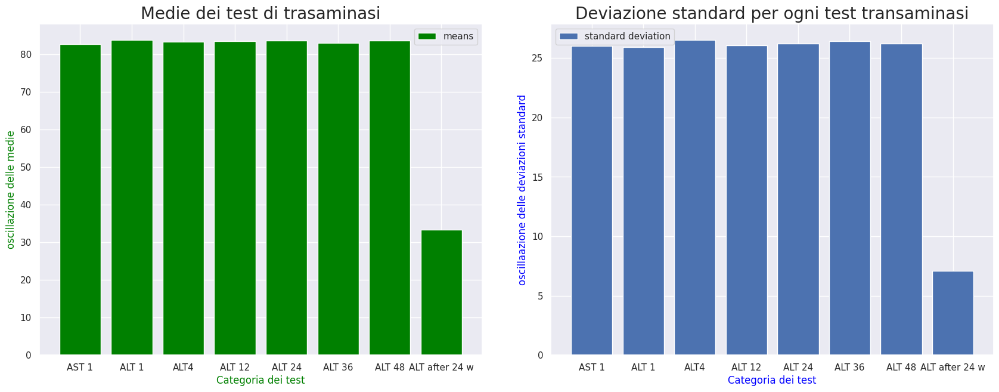

In [56]:
# Creazione dei due barplot
# fig, ax = plt.subplots()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 7.5))
# Primo barplot
ax1.bar(column_transaminasi, means_transaminasi, label='means', color='green')

# Secondo barplot
ax2.bar(column_transaminasi, std_transaminasi, label='standard deviation')

# Spaziatura tra i due grafici
fig.tight_layout(pad=5.0)

ax1.legend()
ax1.set_title('Medie dei test di trasaminasi', fontsize=20)
ax1.set_xlabel('Categoria dei test', color='green')
ax1.set_ylabel('oscillazione delle medie', color='green')
ax2.legend()
ax2.set_title('Deviazione standard per ogni test transaminasi',fontsize=20)
ax2.set_xlabel('Categoria dei test', color='blue')
ax2.set_ylabel('oscillaazione delle deviazioni standard', color='blue')

# Aggiunta di legenda e titoli
#ax.legend()
#plt.title('Confronto tra due barplot')
#fig.xlabel('Categorie')
#fig.ylabel('Valori')

plt.show()

Escludendo dall'analisi per un momento AST che risulta essere una tipologia di test differente sembra che i restanti test si mantengano per lo più stabili, inoltre è interressante osservare che questi test sono presi a distanza  di tempo per monitorare le transaminasi che sono un altro parametro di infiammazione del fegato per cui quello che possiamo concludere è che questi parametri risultano mantenersi costanti nel tempo nonostante il trattamento ricevuto. Sottolineamo però che nell'ultimo esame a distanza di 24 settimane dalla fine del trattamento acuto i valori sembrano rientrare nella norma e la deviazione standard bassa ci dice che questo avviene con regolarità per la maggiorparte del campione osservato. Dalle analisi condotte e visualizzando il file excel delle transaminasi non sembrano esserci possibili errori di compilazione del dato o outlier e i rialzi nei vari possono essere dovuti a cause estrene quali alimentazione o altri fattori di incidenza, vi sono solo 2 casi in cui i dati lascino il sospetto di un problema di error/outlier e sono il primo esempio del dataset che risulta essere contagiato dal virus del HCV come dimostra il risultato RNA Base, ma i range del alt  rientrano non solo normalizzandosi ma toccando valori minimi e il terzo esempio.

In [ ]:
from sklearn.decomposition import PCA
# Creazione di un oggetto PCA
pca = PCA(n_components=1)

# Addestramento del modello PCA sui dati
pca.fit(X)

# Riduzione della dimensionalità del dataset
X_reduced = pca.transform(X)
